# TP 3

## Importaciones generales y cargo de csv's

In [1]:
# importacion general de librerias y de visualizacion (matplotlib y seaborn)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

plt.style.use('default') # haciendo los graficos un poco mas bonitos en matplotlib
#plt.rcParams['figure.figsize'] = (20, 10)

sns.set(style="whitegrid") # seteando tipo de grid en seaborn

pd.options.display.float_format = '{:20,.2f}'.format # suprimimos la notacion cientifica en los outputs

import warnings
warnings.filterwarnings('ignore')

from datetime import datetime
import numpy as np
import time

## Modelo 1 - Random Forest

### Cargo los archivos ya encodeados

In [2]:
df_train = pd.read_csv("df_train_encodeado_completo (3).csv")
#df_test = pd.read_csv("df_test_encoding_completo.csv")

In [3]:
df_train

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,2987000,0,86400,68.50,13926,0.00,150.00,142.00,315.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,2987001,0,86401,29.00,2755,404.00,150.00,102.00,325.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2987002,0,86469,59.00,4663,490.00,150.00,166.00,330.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,2987003,0,86499,50.00,18132,567.00,150.00,117.00,476.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,2987004,0,86506,50.00,4497,514.00,150.00,102.00,420.00,87.00,...,0.00,0.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
543134,3530134,0,14327565,917.81,12544,321.00,150.00,226.00,184.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543135,3530135,0,14327595,26.95,12598,111.00,150.00,166.00,310.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543136,3530136,0,14327620,117.00,11919,170.00,150.00,224.00,204.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543137,3530137,0,14327620,102.00,12449,174.00,150.00,117.00,143.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [4]:
for i in df_train.columns: 
    promedio = 100*df_train[i].isnull().sum()/len(df_train[i])
    if (promedio > 0):
        print("La columna " + i + " tiene " + str(promedio) + " % de elementos nulos")

La columna C1 tiene 0.00018411493190509243 % de elementos nulos
La columna C2 tiene 0.00018411493190509243 % de elementos nulos
La columna C3 tiene 0.00018411493190509243 % de elementos nulos
La columna C4 tiene 0.00018411493190509243 % de elementos nulos
La columna C5 tiene 0.00018411493190509243 % de elementos nulos
La columna C6 tiene 0.00018411493190509243 % de elementos nulos
La columna C7 tiene 0.00018411493190509243 % de elementos nulos
La columna C8 tiene 0.00018411493190509243 % de elementos nulos
La columna C9 tiene 0.00018411493190509243 % de elementos nulos
La columna C10 tiene 0.00018411493190509243 % de elementos nulos
La columna C11 tiene 0.00018411493190509243 % de elementos nulos
La columna C12 tiene 0.00018411493190509243 % de elementos nulos
La columna C13 tiene 0.00018411493190509243 % de elementos nulos
La columna C14 tiene 0.00018411493190509243 % de elementos nulos
La columna D1 tiene 0.00018411493190509243 % de elementos nulos
La columna D2 tiene 0.0001841149319

In [5]:
df_train.fillna(0, inplace = True)
df_train

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,2987000,0,86400,68.50,13926,0.00,150.00,142.00,315.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,2987001,0,86401,29.00,2755,404.00,150.00,102.00,325.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2987002,0,86469,59.00,4663,490.00,150.00,166.00,330.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,2987003,0,86499,50.00,18132,567.00,150.00,117.00,476.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,2987004,0,86506,50.00,4497,514.00,150.00,102.00,420.00,87.00,...,0.00,0.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
543134,3530134,0,14327565,917.81,12544,321.00,150.00,226.00,184.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543135,3530135,0,14327595,26.95,12598,111.00,150.00,166.00,310.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543136,3530136,0,14327620,117.00,11919,170.00,150.00,224.00,204.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
543137,3530137,0,14327620,102.00,12449,174.00,150.00,117.00,143.00,87.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [6]:
columnas = list(df_train.columns)
columnas;

In [7]:
columnas_sin_isFraud = columnas
columnas_sin_isFraud.remove('isFraud')
columnas_sin_isFraud;

In [8]:
columnas_sin_isFraud_y_sin_TransactionID = columnas_sin_isFraud
columnas_sin_isFraud_y_sin_TransactionID.remove('TransactionID')
columnas_sin_isFraud_y_sin_TransactionID;

### Entrenamiento

In [9]:
import numpy as np
import math
from tqdm import tqdm
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, ConfusionMatrixDisplay, confusion_matrix

from sklearn.model_selection import train_test_split, RandomizedSearchCV, KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree

from tqdm import tqdm

In [10]:
points = df_train[columnas_sin_isFraud_y_sin_TransactionID].values
points

array([[8.6400000e+04, 6.8500000e+01, 1.3926000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [8.6401000e+04, 2.9000000e+01, 2.7550000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [8.6469000e+04, 5.9000000e+01, 4.6630000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.4327620e+07, 1.1700000e+02, 1.1919000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.4327620e+07, 1.0200000e+02, 1.2449000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.4327647e+07, 1.7100000e+02, 8.3200000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]])

In [11]:
points.size/495

566181.2606060606

In [12]:
labels = df_train['isFraud'].values
labels

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

#### Separo en train y validation

In [135]:
X_train, X_test, y_train, y_test = train_test_split(points, labels, test_size = 0.3, random_state = 0)

In [136]:
# X_train, X_test, y_train, y_test = train_test_split(points, labels, test_size=0.5)

In [137]:
X_train

array([[6.5261270e+06, 4.7950000e+01, 9.5000000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.6338840e+06, 2.5419000e+01, 9.0260000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2085851e+07, 5.9000000e+01, 7.9740000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [2.3078680e+06, 7.6023000e+01, 1.4037000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1032606e+07, 3.3100000e+02, 4.4360000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [7.5920600e+06, 4.7950000e+01, 1.7640000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]])

In [138]:
X_train.shape

(380197, 516)

In [139]:
y_train

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [140]:
y_train.shape

(380197,)

In [141]:
X_test

array([[1.3032888e+07, 1.1040000e+03, 1.6659000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [7.3410120e+06, 4.7950000e+01, 1.2797000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.0783470e+06, 1.2995000e+02, 9.5000000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.7141590e+06, 1.7100000e+02, 6.8680000e+03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [3.2785550e+06, 5.9000000e+01, 1.7188000e+04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [8.5653570e+06, 3.0000000e+02, 9.8030000e+03, ..., 0.0000000e+00,
        1.0000000e+00, 0.0000000e+00]])

In [142]:
X_test.shape

(162942, 516)

In [143]:
y_test

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [144]:
y_test.shape

(162942,)

#### RandomForestClassifier 1

In [145]:
rf_model_1 = RandomForestClassifier(n_estimators = 10, random_state = 0, verbose=2)

In [146]:
rf_model_1.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 10


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.3s remaining:    0.0s


building tree 2 of 10
building tree 3 of 10
building tree 4 of 10
building tree 5 of 10
building tree 6 of 10
building tree 7 of 10
building tree 8 of 10
building tree 9 of 10
building tree 10 of 10


[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:   54.6s finished


RandomForestClassifier(n_estimators=10, random_state=0, verbose=2)

In [147]:
print(classification_report(y_train, rf_model_1.predict(X_train)))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.6s finished


              precision    recall  f1-score   support

           0       1.00      1.00      1.00    366968
           1       1.00      0.91      0.95     13229

    accuracy                           1.00    380197
   macro avg       1.00      0.95      0.97    380197
weighted avg       1.00      1.00      1.00    380197



In [148]:
roc_auc_score(y_train, rf_model_1.predict_proba(X_train)[:,1])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.7s finished


0.9999698130832277

In [149]:
print(classification_report(y_test, rf_model_1.predict(X_test)))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.6s finished


              precision    recall  f1-score   support

           0       0.98      1.00      0.99    157339
           1       0.93      0.42      0.58      5603

    accuracy                           0.98    162942
   macro avg       0.95      0.71      0.78    162942
weighted avg       0.98      0.98      0.97    162942



In [150]:
roc_auc_score(y_test, rf_model_1.predict_proba(X_test)[:,1])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.6s finished


0.8783071653367425

In [151]:
importance = rf_model_1.feature_importances_
importance

array([2.85186142e-02, 2.49807621e-02, 2.28217968e-02, 1.96736391e-02,
       3.09034795e-03, 1.00516290e-02, 1.82331919e-02, 2.09302991e-03,
       7.84816991e-03, 2.23658414e-03, 1.38420046e-02, 6.57458995e-03,
       2.23004253e-02, 9.03434400e-03, 1.51321076e-05, 8.43852577e-03,
       2.07052804e-03, 8.90658805e-03, 2.60774466e-03, 5.40345487e-03,
       4.77844021e-03, 9.85214227e-03, 9.46856045e-03, 5.18749765e-03,
       1.30604320e-02, 1.55895080e-02, 7.15913562e-03, 7.02861456e-03,
       4.27456340e-03, 7.66528848e-03, 4.10311267e-03, 1.78896045e-03,
       9.44714245e-04, 3.56041950e-03, 3.00596166e-03, 7.09548492e-03,
       4.84408331e-03, 1.59481363e-03, 1.08680429e-03, 1.43726067e-03,
       8.63744417e-03, 5.33576041e-04, 1.08945393e-03, 1.89008572e-03,
       1.67930929e-03, 2.23688699e-03, 9.79359041e-04, 1.42349517e-03,
       7.99004377e-04, 1.20821848e-03, 4.91865206e-04, 4.85814165e-04,
       2.09038411e-03, 2.45024716e-03, 7.15301956e-04, 2.11074167e-04,
      

### Pruebo el modelo en el de test

In [152]:
df_test = pd.read_csv("df_test_encoding_completo (4).csv")

In [153]:
df_test

,TransactionID,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,3663549,18403224,31.95,10409,111.00,150.00,226.00,170.00,87.00,1.00,...,0,0,1,0,0,0,0,0,0,0
1,3663550,18403263,49.00,4272,111.00,150.00,226.00,299.00,87.00,4.00,...,0,0,1,0,0,0,0,0,0,0
2,3663551,18403310,171.00,4476,574.00,150.00,226.00,472.00,87.00,"2,635.00",...,0,0,1,0,0,0,0,0,0,0
3,3663552,18403310,284.95,10989,360.00,150.00,166.00,205.00,87.00,17.00,...,0,0,1,0,0,0,0,0,0,0
4,3663553,18403317,67.95,18018,452.00,150.00,117.00,264.00,87.00,6.00,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,4170235,34214279,94.68,13832,375.00,185.00,224.00,284.00,60.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506687,4170236,34214287,12.17,3154,408.00,185.00,224.00,0.00,0.00,0.00,...,0,0,0,0,0,0,0,0,0,0
506688,4170237,34214326,49.00,16661,490.00,150.00,226.00,327.00,87.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506689,4170238,34214337,202.00,16621,516.00,150.00,224.00,177.00,87.00,0.00,...,0,0,1,0,0,0,0,0,0,0


In [154]:
for i in df_test.columns: 
    promedio = 100*df_test[i].isnull().sum()/len(df_test[i])
    if (promedio > 0):
        print("La columna " + i + " tiene " + str(promedio) + " % de elementos nulos")

In [155]:
df_test_resultados = df_test['TransactionID']
df_test_resultados.head()

0    3663549
1    3663550
2    3663551
3    3663552
4    3663553
Name: TransactionID, dtype: int64

In [156]:
df_test.drop(columns = ['TransactionID'], inplace = True)
df_test

,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,18403224,31.95,10409,111.00,150.00,226.00,170.00,87.00,1.00,0.00,...,0,0,1,0,0,0,0,0,0,0
1,18403263,49.00,4272,111.00,150.00,226.00,299.00,87.00,4.00,0.00,...,0,0,1,0,0,0,0,0,0,0
2,18403310,171.00,4476,574.00,150.00,226.00,472.00,87.00,"2,635.00",0.00,...,0,0,1,0,0,0,0,0,0,0
3,18403310,284.95,10989,360.00,150.00,166.00,205.00,87.00,17.00,0.00,...,0,0,1,0,0,0,0,0,0,0
4,18403317,67.95,18018,452.00,150.00,117.00,264.00,87.00,6.00,0.00,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,34214279,94.68,13832,375.00,185.00,224.00,284.00,60.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506687,34214287,12.17,3154,408.00,185.00,224.00,0.00,0.00,0.00,157.00,...,0,0,0,0,0,0,0,0,0,0
506688,34214326,49.00,16661,490.00,150.00,226.00,327.00,87.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506689,34214337,202.00,16621,516.00,150.00,224.00,177.00,87.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0


In [157]:
valores_predecidos = rf_model_1.predict_proba(df_test)
valores_predecidos

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    2.4s finished


array([[0.9, 0.1],
       [0.7, 0.3],
       [0.8, 0.2],
       ...,
       [0.8, 0.2],
       [0.8, 0.2],
       [1. , 0. ]])

In [158]:
lista_de_probas = []

for i in range(len(valores_predecidos)):
    lista_de_probas.append(valores_predecidos[i][1])

lista_de_probas

[0.1,
 0.3,
 0.2,
 0.0,
 0.0,
 0.0,
 0.2,
 0.0,
 0.0,
 0.2,
 0.0,
 0.1,
 0.3,
 0.0,
 0.2,
 0.0,
 0.2,
 0.3,
 0.0,
 0.1,
 0.2,
 0.1,
 0.2,
 0.1,
 0.0,
 0.1,
 0.0,
 0.2,
 0.1,
 0.2,
 0.3,
 0.2,
 0.1,
 0.1,
 0.1,
 0.1,
 0.1,
 0.3,
 0.3,
 0.3,
 0.3,
 0.2,
 0.0,
 0.0,
 0.1,
 0.0,
 0.3,
 0.0,
 0.1,
 0.2,
 0.0,
 0.0,
 0.1,
 0.6,
 0.0,
 0.0,
 0.1,
 0.1,
 0.3,
 0.3,
 0.2,
 0.1,
 0.0,
 0.3,
 0.0,
 0.2,
 0.0,
 0.0,
 0.3,
 0.2,
 0.0,
 0.0,
 0.0,
 0.1,
 0.0,
 0.1,
 0.0,
 0.2,
 0.0,
 0.3,
 0.2,
 0.2,
 0.0,
 0.2,
 0.0,
 0.1,
 0.0,
 0.1,
 0.0,
 0.1,
 0.0,
 0.3,
 0.0,
 0.1,
 0.0,
 0.0,
 0.1,
 0.0,
 0.1,
 0.3,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.3,
 0.3,
 0.1,
 0.1,
 0.2,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.2,
 0.0,
 0.0,
 0.2,
 0.1,
 0.0,
 0.0,
 0.0,
 0.0,
 0.3,
 0.1,
 0.3,
 0.0,
 0.1,
 0.1,
 0.1,
 0.0,
 0.0,
 0.1,
 0.2,
 0.0,
 0.2,
 0.0,
 0.0,
 0.0,
 0.2,
 0.0,
 0.2,
 0.3,
 0.1,
 0.0,
 0.0,
 0.0,
 0.2,
 0.2,
 0.2,
 0.2,
 0.0,
 0.1,
 0.0,
 0.0,
 0.2,
 0.4,
 0.1,
 0.0,
 0.0,
 0.1,
 0.0,
 0.2,
 0.1,
 0.2,
 0.2

In [159]:
submit = pd.concat([df_test_resultados, pd.Series(lista_de_probas, name='isFraud')], axis=1)
submit.set_index('TransactionID', inplace=True)
submit.head()

,isFraud
TransactionID,
3663549,0.10
3663550,0.30
3663551,0.20
3663552,0.00
3663553,0.00


In [160]:
submit.to_csv('submit_random_forest_1.csv', index = True)

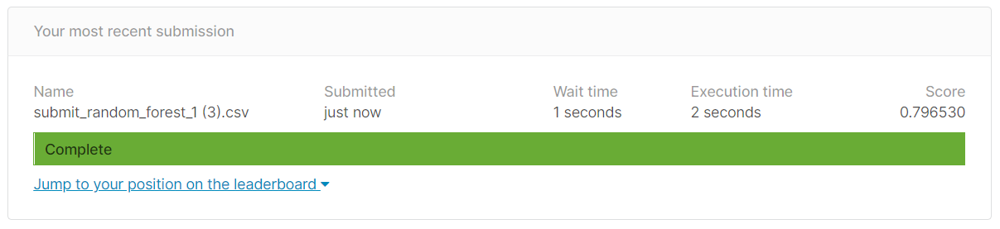
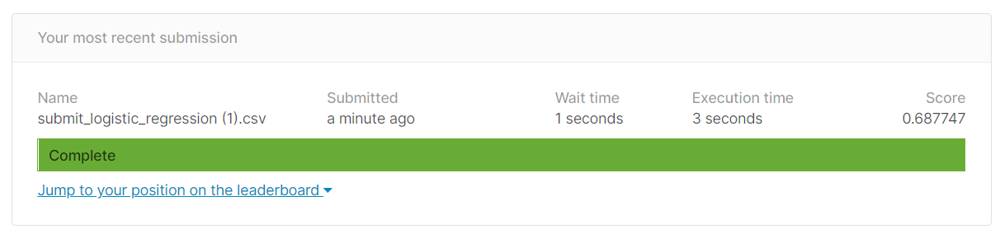

### Parámetros más importantes

In [161]:
len(importance)

516

In [162]:
puntajes_de_las_columnas = {}
count = 1

# summarize feature importance
for i,v in enumerate(importance):
    print(count, ' - Columna', columnas_sin_isFraud_y_sin_TransactionID[i], '  -  Score: %.5f' % (v))
    #puntajes_de_las_columnas.append((columnas_sin_isFraud_y_sin_TransactionID[i], v))
    #puntajes_de_las_columnas.update({v: columnas_sin_isFraud_y_sin_TransactionID[i]})
    puntajes_de_las_columnas.update({columnas_sin_isFraud_y_sin_TransactionID[i] : v})
    
    count = count+1

1  - Columna TransactionDT   -  Score: 0.02852
2  - Columna TransactionAmt   -  Score: 0.02498
3  - Columna card1   -  Score: 0.02282
4  - Columna card2   -  Score: 0.01967
5  - Columna card3   -  Score: 0.00309
6  - Columna card5   -  Score: 0.01005
7  - Columna addr1   -  Score: 0.01823
8  - Columna addr2   -  Score: 0.00209
9  - Columna dist1   -  Score: 0.00785
10  - Columna dist2   -  Score: 0.00224
11  - Columna P_emaildomain   -  Score: 0.01384
12  - Columna R_emaildomain   -  Score: 0.00657
13  - Columna C1   -  Score: 0.02230
14  - Columna C2   -  Score: 0.00903
15  - Columna C3   -  Score: 0.00002
16  - Columna C4   -  Score: 0.00844
17  - Columna C5   -  Score: 0.00207
18  - Columna C6   -  Score: 0.00891
19  - Columna C7   -  Score: 0.00261
20  - Columna C8   -  Score: 0.00540
21  - Columna C9   -  Score: 0.00478
22  - Columna C10   -  Score: 0.00985
23  - Columna C11   -  Score: 0.00947
24  - Columna C12   -  Score: 0.00519
25  - Columna C13   -  Score: 0.01306
26  - Colum

In [163]:
puntajes_de_las_columnas

{'TransactionDT': 0.028518614204609015,
 'TransactionAmt': 0.024980762054705733,
 'card1': 0.022821796843959796,
 'card2': 0.01967363905906621,
 'card3': 0.0030903479468959885,
 'card5': 0.01005162898682994,
 'addr1': 0.018233191891506108,
 'addr2': 0.0020930299120039556,
 'dist1': 0.007848169905721264,
 'dist2': 0.00223658413800915,
 'P_emaildomain': 0.013842004582895242,
 'R_emaildomain': 0.006574589949997952,
 'C1': 0.02230042532154412,
 'C2': 0.009034344004682844,
 'C3': 1.5132107568521548e-05,
 'C4': 0.008438525767004077,
 'C5': 0.0020705280423497356,
 'C6': 0.008906588053107152,
 'C7': 0.0026077446621261937,
 'C8': 0.0054034548710268915,
 'C9': 0.004778440214886065,
 'C10': 0.009852142273499264,
 'C11': 0.009468560451531566,
 'C12': 0.005187497650990762,
 'C13': 0.01306043201862456,
 'C14': 0.015589507976984662,
 'D1': 0.007159135616023525,
 'D2': 0.007028614560307918,
 'D3': 0.0042745634005777544,
 'D4': 0.007665288484385027,
 'D5': 0.0041031126651595124,
 'D6': 0.00178896044708

In [164]:
len(puntajes_de_las_columnas.keys())

516

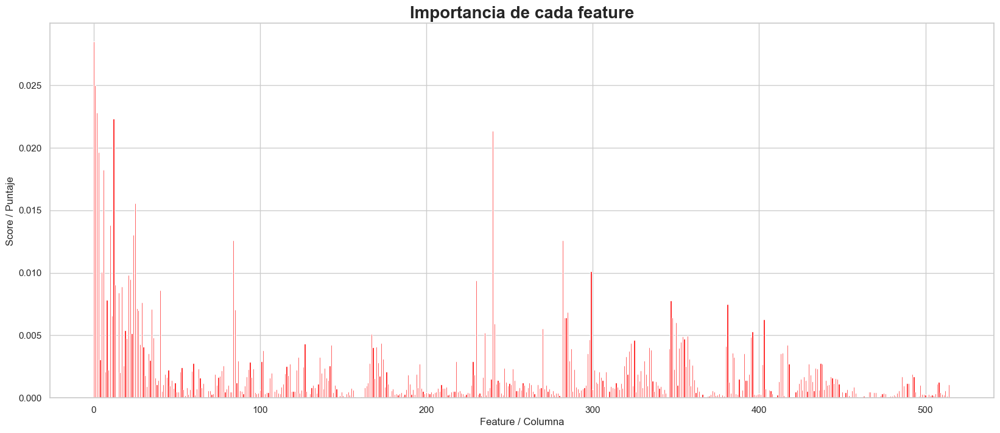

In [165]:
# plot feature importance
fig = plt.figure(figsize = (20, 8))
plt.bar([x for x in range(len(importance))], importance, color ='red')
plt.xlabel("Feature / Columna")
plt.ylabel("Score / Puntaje")
plt.title("Importancia de cada feature", weight = 'bold', size = 20)
plt.show()

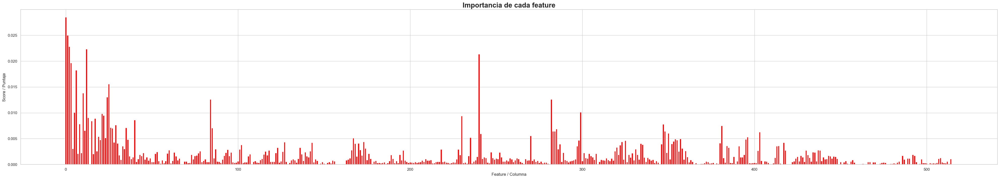

In [166]:
# plot feature importance
fig = plt.figure(figsize = (50, 8))
plt.bar([x for x in range(len(importance))], importance, color ='red')
plt.xlabel("Feature / Columna")
plt.ylabel("Score / Puntaje")
plt.title("Importancia de cada feature", weight = 'bold', size = 20)
plt.show()

In [167]:
parametros_ordenados = pd.DataFrame.from_dict(puntajes_de_las_columnas, orient='index')
parametros_ordenados

,0
TransactionDT,0.03
TransactionAmt,0.02
card1,0.02
card2,0.02
card3,0.00
...,...
samsung,0.00
sm,0.00
trident,0.00
windows,0.00


In [168]:
parametros_ordenados = parametros_ordenados.reset_index()
parametros_ordenados

,index,0
0,TransactionDT,0.03
1,TransactionAmt,0.02
2,card1,0.02
3,card2,0.02
4,card3,0.00
...,...,...
511,samsung,0.00
512,sm,0.00
513,trident,0.00
514,windows,0.00


In [169]:
parametros_ordenados.rename(columns={'index': 'parametro', parametros_ordenados.columns[1]: 'puntaje'},inplace=True)
parametros_ordenados

,parametro,puntaje
0,TransactionDT,0.03
1,TransactionAmt,0.02
2,card1,0.02
3,card2,0.02
4,card3,0.00
...,...,...
511,samsung,0.00
512,sm,0.00
513,trident,0.00
514,windows,0.00


In [170]:
parametros_ordenados = parametros_ordenados.sort_values(by=['puntaje'])
parametros_ordenados

,parametro,puntaje
515,r16nw,0.00
345,V305,0.00
410,ProductCD_nan,0.00
416,card6_charge card,0.00
419,card6_debit or credit,0.00
...,...,...
240,V200,0.02
12,C1,0.02
2,card1,0.02
1,TransactionAmt,0.02


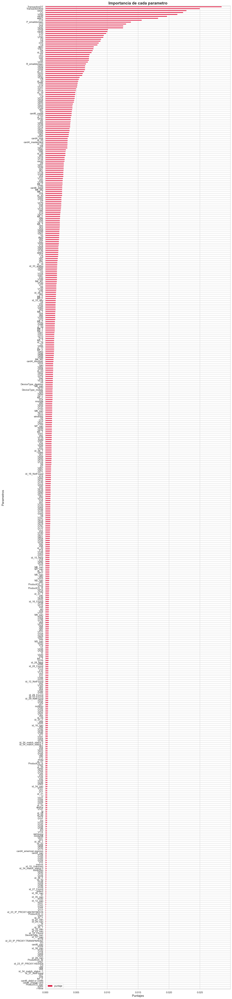

In [171]:
parametros_ordenados.plot.barh("parametro","puntaje",  rot = 0, color = 'crimson', figsize=(15,80))
plt.xlabel('Puntajes', size = 14)
plt.ylabel('Parametros', size = 14)
#plt.legend(("Importancia de cada parametro"),loc="lower right")
plt.title('Importancia de cada parametro', fontweight='bold', size = 18)
plt.show()

A partir de este gráfico se puede suponer que los parámetros más importantes son: TransactionDT, TransactionAmt, card1 y C1.

### Búsqueda de hiperparámetros

A partir de los resultados obtenidos en el otro archivo:

In [50]:
print('Parametros usados en el modelo:\n')
print(rf_model_1.get_params())

Parametros usados en el modelo:

{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': 'auto', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 10, 'n_jobs': None, 'oob_score': False, 'random_state': 0, 'verbose': 2, 'warm_start': False}


In [51]:
from sklearn.model_selection import RandomizedSearchCV

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 1, stop = 300, num = 10)]

# Number of features to consider at every split
max_features = ['sqrt', 'log2']

# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 10, num = 11)]
max_depth.append(None)

# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]

# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]

# Method of selecting samples for training each tree
bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [1, 34, 67, 100, 133, 167, 200, 233, 266, 300], 'max_features': ['sqrt', 'log2'], 'max_depth': [1, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [52]:
# Use the random grid to search for best hyperparameters

# First create the base model to tune
rf = RandomForestClassifier()

# Random search of parameters, using 3 fold cross validation, 

# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, verbose=300, random_state=0)

# Fit the random search model
rf_random.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5; 1/10] START bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67
[CV 1/5; 1/10] END bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67;, score=0.968 total time=  24.8s
[CV 2/5; 1/10] START bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67
[CV 2/5; 1/10] END bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67;, score=0.969 total time=  27.1s
[CV 3/5; 1/10] START bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67
[CV 3/5; 1/10] END bootstrap=False, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=67;, score=0.969 total time=  26.7s
[CV 4/5; 1/10] START bootstrap=False, max_depth=3, max_features=sqrt, min_samples_le

RandomizedSearchCV(estimator=RandomForestClassifier(),
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [1, 1, 2, 3, 4, 5, 6, 7, 8,
                                                      9, 10, None],
                                        'max_features': ['sqrt', 'log2'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [1, 34, 67, 100, 133,
                                                         167, 200, 233, 266,
                                                         300]},
                   random_state=0, verbose=300)

In [122]:
mejores_parametros = rf_random.best_params_
mejores_parametros

{'n_estimators': 167,
 'min_samples_split': 2,
 'min_samples_leaf': 4,
 'max_features': 'log2',
 'max_depth': None,
 'bootstrap': True}

In [172]:
best_rf = RandomForestClassifier(n_estimators = 167, min_samples_split = 2, min_samples_leaf = 4, max_features = 'log2', max_depth = None, bootstrap = True, verbose=300, random_state=0)
best_rf

RandomForestClassifier(max_features='log2', min_samples_leaf=4,
                       n_estimators=167, random_state=0, verbose=300)

In [173]:
best_rf.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
building tree 1 of 167
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s remaining:    0.0s
building tree 2 of 167
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    4.7s remaining:    0.0s
building tree 3 of 167
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    7.4s remaining:    0.0s
building tree 4 of 167
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   10.5s remaining:    0.0s
building tree 5 of 167
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   13.3s remaining:    0.0s
building tree 6 of 167
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:   16.0s remaining:    0.0s
building tree 7 of 167
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:   18.4s remaining:    0.0s
building tree 8 of 167
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   21.2s remaining:    0.0s
building tree 9 of 167
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:   24.3s remaining: 

RandomForestClassifier(max_features='log2', min_samples_leaf=4,
                       n_estimators=167, random_state=0, verbose=300)

In [174]:
preds_y_train = best_rf.predict(X_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  

In [175]:
print(classification_report(y_train, preds_y_train))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99    366968
           1       0.98      0.40      0.57     13229

    accuracy                           0.98    380197
   macro avg       0.98      0.70      0.78    380197
weighted avg       0.98      0.98      0.97    380197



In [176]:
probas_y_train = best_rf.predict_proba(X_train)[:,1]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  

In [177]:
roc_y_train = roc_auc_score(y_train, probas_y_train)
roc_y_train

0.9829278811524579

In [178]:
preds_y_test = best_rf.predict(X_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  

In [179]:
print(classification_report(y_test, preds_y_test))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99    157339
           1       0.93      0.32      0.48      5603

    accuracy                           0.98    162942
   macro avg       0.95      0.66      0.73    162942
weighted avg       0.97      0.98      0.97    162942



In [180]:
probas_y_test = best_rf.predict_proba(X_test)[:,1]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  

In [181]:
roc_y_test = roc_auc_score(y_test, probas_y_test)
roc_y_test

0.9217609544626995

### Grafico del best randomForest

In [96]:
estimator = best_rf.estimators_[5]
estimator

DecisionTreeClassifier(max_features='log2', min_samples_leaf=4,
                       random_state=1537364731)

In [97]:
from sklearn.tree import export_graphviz

# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = columnas_sin_isFraud_y_sin_TransactionID,
                class_names = columnas[1],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

In [98]:
# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree_con_5.png')

In [99]:
estimator = best_rf.estimators_[0]
estimator

DecisionTreeClassifier(max_features='log2', min_samples_leaf=4,
                       random_state=209652396)

In [100]:
from sklearn.tree import export_graphviz

# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = columnas_sin_isFraud_y_sin_TransactionID,
                class_names = columnas[1],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

In [101]:
# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree_con_0.png')

### Matriz de Confusion del best randomForest

In [182]:
matrix = confusion_matrix(y_test, preds_y_test)
matrix

array([[157209,    130],
       [  3789,   1814]], dtype=int64)

Text(0.5, 1.0, 'Matriz de confusión para el randomForestClassifier con los mejores parámetros')

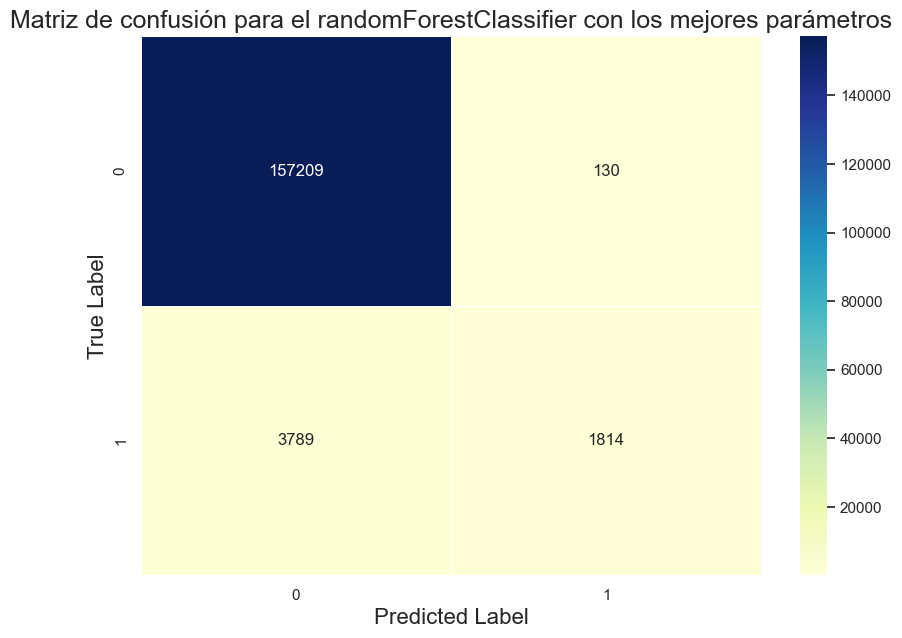

In [183]:
df_cm = pd.DataFrame(matrix)
plt.figure(figsize = (10,7))
s = sns.heatmap(df_cm, annot=True, cmap="YlGnBu", fmt='g', linewidths=.5)
s.set_xlabel('Predicted Label', fontsize=16)
s.set_ylabel('True Label', fontsize=16)
s.set_title('Matriz de confusión para el randomForestClassifier con los mejores parámetros', fontsize=18)

Con la matriz de confusión se puede ver que el modelo tiene pocos falsos positivos (es decir, casos que predije como falsos que no eran) pero tiene muchos falsos negativos (es deecir, casos que SI eran fraude y no los detecté) si lo comparamos con la cantidad de casos que efectivamente reconocimos como fraude.

### Pruebo el modelo 1 con mejores parametros en el de test

In [184]:
df_test = pd.read_csv("df_test_encoding_completo (4).csv")
df_test

,TransactionID,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,3663549,18403224,31.95,10409,111.00,150.00,226.00,170.00,87.00,1.00,...,0,0,1,0,0,0,0,0,0,0
1,3663550,18403263,49.00,4272,111.00,150.00,226.00,299.00,87.00,4.00,...,0,0,1,0,0,0,0,0,0,0
2,3663551,18403310,171.00,4476,574.00,150.00,226.00,472.00,87.00,"2,635.00",...,0,0,1,0,0,0,0,0,0,0
3,3663552,18403310,284.95,10989,360.00,150.00,166.00,205.00,87.00,17.00,...,0,0,1,0,0,0,0,0,0,0
4,3663553,18403317,67.95,18018,452.00,150.00,117.00,264.00,87.00,6.00,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,4170235,34214279,94.68,13832,375.00,185.00,224.00,284.00,60.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506687,4170236,34214287,12.17,3154,408.00,185.00,224.00,0.00,0.00,0.00,...,0,0,0,0,0,0,0,0,0,0
506688,4170237,34214326,49.00,16661,490.00,150.00,226.00,327.00,87.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506689,4170238,34214337,202.00,16621,516.00,150.00,224.00,177.00,87.00,0.00,...,0,0,1,0,0,0,0,0,0,0


In [185]:
df_test_resultados = df_test['TransactionID']
df_test_resultados.head()

0    3663549
1    3663550
2    3663551
3    3663552
4    3663553
Name: TransactionID, dtype: int64

In [186]:
df_test.drop(columns = ['TransactionID'], inplace = True)
df_test

,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,...,moto,mra58k,nan,nrd90m,rv,samsung,sm,trident,windows,r16nw
0,18403224,31.95,10409,111.00,150.00,226.00,170.00,87.00,1.00,0.00,...,0,0,1,0,0,0,0,0,0,0
1,18403263,49.00,4272,111.00,150.00,226.00,299.00,87.00,4.00,0.00,...,0,0,1,0,0,0,0,0,0,0
2,18403310,171.00,4476,574.00,150.00,226.00,472.00,87.00,"2,635.00",0.00,...,0,0,1,0,0,0,0,0,0,0
3,18403310,284.95,10989,360.00,150.00,166.00,205.00,87.00,17.00,0.00,...,0,0,1,0,0,0,0,0,0,0
4,18403317,67.95,18018,452.00,150.00,117.00,264.00,87.00,6.00,0.00,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506686,34214279,94.68,13832,375.00,185.00,224.00,284.00,60.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506687,34214287,12.17,3154,408.00,185.00,224.00,0.00,0.00,0.00,157.00,...,0,0,0,0,0,0,0,0,0,0
506688,34214326,49.00,16661,490.00,150.00,226.00,327.00,87.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0
506689,34214337,202.00,16621,516.00,150.00,224.00,177.00,87.00,0.00,0.00,...,0,0,1,0,0,0,0,0,0,0


In [187]:
valores_predecidos = best_rf.predict_proba(df_test)
valores_predecidos

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    2.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  

array([[0.98537787, 0.01462213],
       [0.96954155, 0.03045845],
       [0.97158562, 0.02841438],
       ...,
       [0.97892535, 0.02107465],
       [0.97892954, 0.02107046],
       [0.9787313 , 0.0212687 ]])

In [188]:
lista_de_probas = []

for i in range(len(valores_predecidos)):
    lista_de_probas.append(valores_predecidos[i][1])

lista_de_probas

[0.014622133897261684,
 0.030458452328161023,
 0.028414379174089836,
 0.007575887597002065,
 0.026368833625870947,
 0.00689200626068864,
 0.06749561028991906,
 0.051172732244270755,
 0.01170785399175297,
 0.026116413236706264,
 0.012526295447755246,
 0.008258368755260362,
 0.04640276982225403,
 0.00319396813463715,
 0.03067137272579341,
 0.009565901597199807,
 0.024063733451619704,
 0.02646904154287748,
 0.058984321705664644,
 0.018491000902908894,
 0.06774368527620464,
 0.023195223592624943,
 0.023702544897394578,
 0.03097759896683255,
 0.04616058694643509,
 0.02387396357500264,
 0.019931586195854206,
 0.02671858146569691,
 0.02510070892521567,
 0.028531027961607197,
 0.08872507180811422,
 0.0272408531489697,
 0.04996071578732767,
 0.028854199411027782,
 0.009144587862457304,
 0.025887784765310926,
 0.030535477142157458,
 0.0604902897429877,
 0.11297449270522751,
 0.05659623144653084,
 0.17867150537858212,
 0.02670183365831581,
 0.01130999129548224,
 0.023376451945690883,
 0.035743448

In [189]:
submit = pd.concat([df_test_resultados, pd.Series(lista_de_probas, name='isFraud')], axis=1)
submit.set_index('TransactionID', inplace=True)
submit.head()

,isFraud
TransactionID,
3663549,0.01
3663550,0.03
3663551,0.03
3663552,0.01
3663553,0.03


In [190]:
submit.to_csv('submit_random_forest_best_params.csv', index = True)

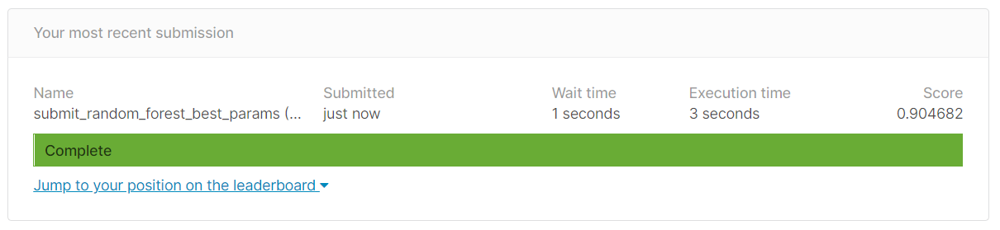

### Variación de porcentaje de validation con el randomForest de mejores parámetros

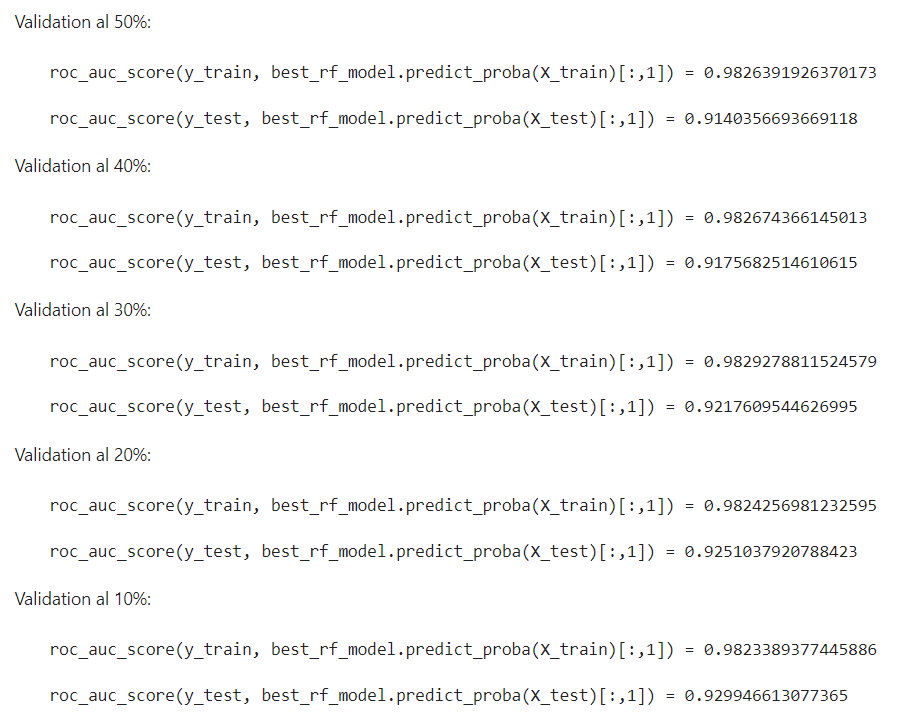

La mejor versión se obtuvo con validation al 30%